In [11]:
from IPython.display import display, HTML
# Additional JavaScript for toggling code display in Jupyter Notebooks
HTML(
    """
<script src="https://cdnjs.cloudflare.com/ajax/libs/jquery/2.0.3/jquery.min.js "></script>
<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.jp-CodeCell > div.jp-Cell-inputWrapper').hide();
 } else {
 $('div.jp-CodeCell > div.jp-Cell-inputWrapper').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit"
    value="Click here to toggle on/off the raw code."></form>
"""
)

In [ ]:
sc

In [ ]:
sc.install_pypi_package('pyarrow')
sc.install_pypi_package('matplotlib')
sc.install_pypi_package('pandas')
sc.install_pypi_package('numpy')
sc.install_pypi_package('boto3')
sc.install_pypi_package('plotly')
sc.install_pypi_package('wordcloud')
sc.install_pypi_package('collections')
sc.install_pypi_package('langdetect')
sc.install_pypi_package('pyLDAvis')
sc.install_pypi_package('s3fs')
sc.install_pypi_package('IPython')

In [ ]:
%pip install s3fs

In [ ]:
from pyspark.sql import SparkSession
# import os

# os.environ['AWS_PROFILE'] = 'default'
spark = (
    SparkSession.builder.master("yarn")
    .config(
        "spark.jars.packages",
        "org.apache.hadoop:hadoop-aws:3.3.4", # should match hadoop version
    )  
    .config(
        "spark.executor.extraJavaOptions",
        "-Dcom.amazonaws.services.s3.enableV4=true",
    )
    .config(
        "spark.driver.extraJavaOptions",
        "-Dcom.amazonaws.services.s3.enableV4=true",
    )
    .config(
        "spark.hadoop.fs.s3a.aws.credentials.provider",
        'com.amazonaws.auth.profile.ProfileCredentialsProvider,'
        "org.apache.hadoop.fs.s3a.AnonymousAWSCredentialsProvider",
    )
    .config("spark.sql.repl.eagerEval.enabled", True)
    .getOrCreate()
)

In [ ]:
spark.conf.set("spark.sql.execution.arrow.pyspark.enabled", "true")
spark.conf.set("spark.sql.execution.arrow.enabled", "true")

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from pyspark.sql import functions as F
from wordcloud import WordCloud
from collections import ChainMap
from pyspark.sql.types import StringType, IntegerType
from pyspark.ml.feature import (Tokenizer, 
                                StopWordsRemover, 
                                CountVectorizer,
                                IDF)
from pyspark.ml import Pipeline
from pyspark.ml.clustering import LDA
import pickle
from pickle import dump
import s3fs

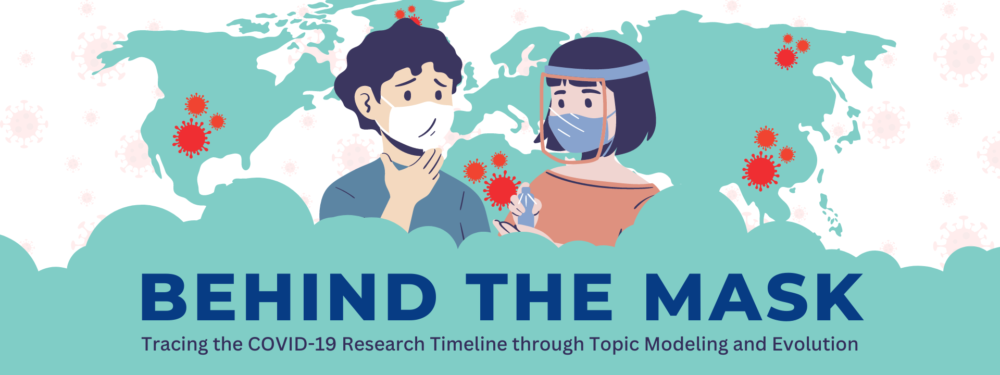

<div id="abstract" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#2F3254; font-weight:bold">ABSTRACT</h1></center>
</div>

<b style='color:#073C84'>Introduction:</b> Given the ongoing and profound impact of COVID-19 globally, there has been a surge in COVID-related publications across various journals. This influx highlights the need to identify and categorize emerging research themes using topic modeling techniques. Such efforts are vital for enriching the research landscape, identifying gaps, and guiding future studies. By pinpointing key areas of focus, researchers can better tackle the challenges posed by COVID-19, its variants, and other potential pandemic-causing viruses. This work not only helps manage the current impact of the pandemic but also prepares us for future threats.

<b style='color:#073C84'>Data Collection:</b> TThe data comes from the COVID-19 Open Research Dataset (CORD-19), which includes full texts and metadata from scholarly publications mainly focused on COVID-19, as well as other coronaviruses like SARS and MERS, and influenza viruses. To prepare this data, we processed the abstracts in the metadata files by extracting date components and filtering out unpublished documents. We also removed any entries that were null, duplicated, non-English, or had short abstracts (less than 100 characters). The cleaned data was then saved as a Parquet file, organized by year and month.

<b style='color:#073C84'>Exploratory Data Analysis:</b> Our initial exploration revealed that the the surge in publishing COVID-19 research articles began in 2020, coinciding with the onset of the pandemic around December 2019. This surge was sustained through 2022, driven by the emergence of the Omicron variant in November 2021. However, there was a noticeable decline in COVID-19 research publications starting from the second quarter of 2022, likely because the virus was causing less disruption than in earlier years. To visualize these trends, we created word clouds that revealed an initial focus on treating COVID-19 in 2020-2021. By 2022-2023, the research focus had shifted towards prevention strategies and reducing the pandemic's broader impacts, indicating a clear evolution in the themes of COVID-19 research over time.

<b style='color:#073C84'>Methodology:</b> To identify topics using Latent Dirichlet Allocation (LDA), we first preprocessed the text data. This involved tokenizing the text, removing stop words, and vectorizing the words based on their term frequencies. With this prepared data, we trained the LDA model to determine the dominant topics for each document and to identify key terms associated with each topic. Utilizing pyLDAvis, we then created visualizations that display the topics for each year. These visualizations reveal the proximity of topics to each other, their prevalence within the overall corpus, and the top 30 most relevant terms for each topic. The relevance of these terms can be adjusted to focus solely on their significance within a specific topic or in comparison to other topics, providing a flexible and insightful exploration of the data.

<b style='color:#073C84'>Results and Discussion:</b> From 2018 to 2022, there was a significant evolution in response to global health developments. Research in 2018 focused more on general medical topics, with some attention on other coronaviruses such as MERS-CoV. This attention on coronaviruses intensified in 2019, with some topics relating to the relation of coronaviruses and bats. In 2020, research was primarily focused on public health responses towards COVID-19 and its impacts towards mental health and education. This was further bolstered by research in 2021 that focused on vaccination, machine learning and COVID-19 diagnosis, and further studies on effects of the pandemic on educational systems. Finally, in 2022, the research primarily focused on the holistic impact of the pandemic, which would include its socio-economic, health, and environmental impacts.

<b style='color:#073C84'>Conclusion:</b> Using LDA, we accomplished two key objectives in our analysis of COVID-19 research data. First, we identified low marginal distribution topics, which are relatively rare but potentially significant. These topics highlighted gaps in the current research that could be explored further by researchers focused on COVID-19. Second, by analyzing topics with high popularity, we conducted trend analysis to discern areas of research that have seen a substantial amount of attention. This analysis helps researchers identify fields that might be oversaturated and consider whether these areas still require extensive study or if efforts should be redirected. 

<b style='color:#073C84'>Scope and Limitations:</b> The study focused exclusively on English abstracts longer than 100 words from 2018 to 2023. While LDA was chosen for its effective interpretability, enhanced by visualization tools like pyLDAvis, other topic modeling techniques such as non-negative matrix factorization and clustering were not explored. Additionally, the LDA model was trained using term frequency rather than term frequency-inverse document frequency (TF-IDF). This decision was based on the observation that using TF-IDF tends to yield broader and less interpretable topics, which could detract from the specificity and clarity needed for effective topic identification.

<b style='color:#073C84'>Way Forward:</b> Moving forward, full-text data may be used to train the LDA model, and further fine-tuning of the model through optimization metrics such as perplexity and log likelihood may be used to determine the ideal number of topics of the model. Lastly, through Grid Search, multiple versions of LDA may be trained on various values of hyperparameters and learning rates, as to create the most optimized model for the given use case.

<div id="intro" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">INTRODUCTION</h1></center>
</div>

<div id="motivation" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Motivation</h3></center>
</div> 

COVID-19 has significantly impacted the global landscape. According to the Worldometer, an independent group providing world statistics in a thought-provoking and timely format, as of April 2024, there have been a cumulative total of 682.6 million COVID-19 cases and 7 million deaths (Worldometer, 2024). Additionally, the World Health Organization (WHO) has forecasted that half of the 3.3 billion global workforce is at risk of losing their jobs due to the pandemic (WHO, 2020). 

With clear evidence of its harmful effects, research has shifted its focus to efforts to end the disease. In fact, there have been a total of 350,000 COVID-related articles published on PubMed Central (PMC) alone (National Library of Medicine, 2024). It is important to note that this metric is just from one journal archive; there are others out there producing thousands of hard-earned articles as well. To emphasize this further, a significant proportion of COVID-19 papers provide new and original information: 48% on Scopus and 37% on Web of Science. Interestingly, 45% of researchers publishing COVID-19 articles usually author papers on energy physics and condensed-matter physics (Nature Index, 2020).

The team empathizes with the tireless efforts of scientists and researchers around the world, who are paving the way back to the normal everyday life experienced globally before the pandemic happened. Therefore, <b style="color:#64928E">this project should be seen as a commemoration of their work and as an avenue to aid them in their future research.</b>

Another motivation that the team has for this project is its scalable and flexible application to different studies and industries, not just those related to the COVID-19 pandemic and public health. Although the project is more relevant now, given the rise in COVID cases this past month, which stands at 125 cases detected each day (Cabico, 2024), and the more than 23 variants actively observed by the CDC in 2024, <b style='color:#073C84'>the team sees potential for topic modeling and evolution to be extended to the 5 million academic articles each year (Curcic, 2023) and to be applied to other industries such as media information and government policy making.</b>

Ultimately, the hard work of researchers, as well as the potential help our project can provide people, prompted the team to pursue tracing the COVID-19 research timeline through topic modeling and evolution.

<div id="prob-statement" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Problem Statement</h3></center>
</div> 

The COVID-19 pandemic is one of the most devastating events of our generation. Most scientists and researchers have put significant focus on understanding the disease and making strides in mitigating its viral and harmful effects. Given the increasing number of cases this past month (Cabico, 2024) as well as heightened number of variants being tracked by the Centers for Disease Control and Prevention this year (2024), support to fight and prevent COVID-19 has again gained traction. Therefore, the question now is:

<b style='color:#073C84'>“How might we use topic modeling techniques to detect and label nascent research themes that could become crucial in managing ongoing and future COVID-19 variants or other pandemics?”</b>

<div id="project-overview" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">PROJECT OVERVIEW</h1></center>
</div>

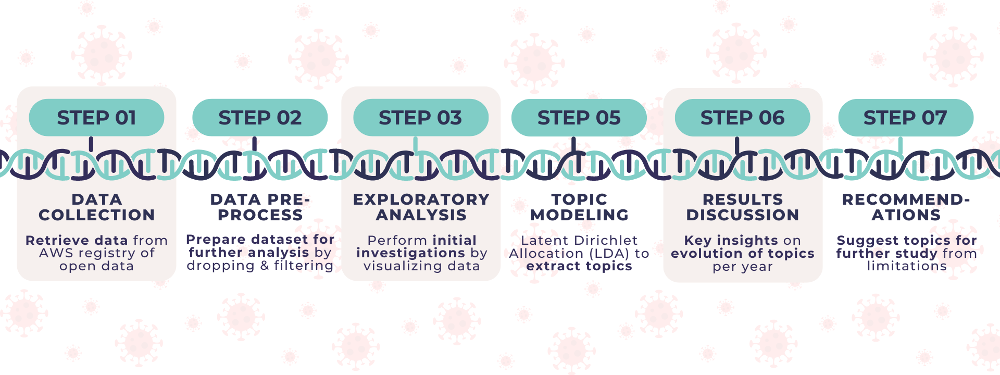

<center><small><b>Figure 1.</b> Overview of the Project Solution </small></center>

The team aims to extract emerging and prevailing themes within COVID-19 and coronavirus-related research to identify future threats and analyze trends that may aid in current and future pandemic research efforts. To achieve this, they start by collecting the COVID-19 Open Research Dataset, which contains text and metadata of COVID-19 and coronavirus-related research articles optimized for machine readability and managed by the Allen Institute of AI, from the Registry of Open Data on AWS. 

After retrieving the data, the subsequent step involves pre-processing it to ensure the information is clean before moving to the exploratory analysis stage. This step includes filtering the needed information and removing null values and duplicates. 

The team then explores the data using multiple visualization techniques to extract initial insights. Specifically, they use a combination of word clouds, line charts, and bar graphs to examine the prevalent words within the titles and the distribution of articles over time.

Topic modeling and topic evolution form the core of the project, utilizing Latent Dirichlet Allocation (LDA) for this purpose. Before applying LDA, however, the data needs to be pre-processed once more. This step specifically prepares the text data for input to LDA. After applying LDA to the data, topics are generated with word importances associated with them, which helps infer the topics' meanings. The team will then synthesize the results using pyLDAvis to identify popular and emerging topics from each year, spanning from 2018 to 2023 (articles in 2022 and 2023 were combined since there were only a handful of publications in 2023).

The project will conclude with a retrospective analysis of the limitations encountered, from which recommendations for future studies will be derived. The team is considering the following enhancements to improve the project: utilizing the full text (body) of the research, employing perplexity or log-likelihood as evaluation metrics, and applying a grid search to optimize the model.

A more detailed explanation of the project pipeline is discussed in Table 1 of the next subsection.

<div id="project-pipeline" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Project Pipeline</h3></center>
</div> 

<table>
    <tr style="color:#073C84; background-color:#80CDC6;">
        <th style="text-align: center"></th>
        <th style="text-align: center">Step</th>
        <th style="text-align: center">Detailed Description</th>
    </tr>
    <tr>
        <th style="text-align: left">1</th>
        <td style="text-align: left">Data Collection</td>
        <td style="text-align: left">The dataset used in this project was obtained directly from the Registry of Open Data on AWS. The team connected to the S3 bucket containing the CORD-19 dataset to load and subsequently process it in preparation for analysis. The data includes full-text and metadata information, which are crucial for executing the project's main methodology. Additionally, the team converted the data into Parquet format to facilitate easy access whenever the code needs to be re-run.</td>
    </tr>
    <tr>
        <th style="text-align: left">2</th>
        <td style="text-align: left">Data Pre-Processing</td>
        <td style="text-align: left">Data pre-processing was particularly necessary because the raw information could not be used as-is. The team implemented several steps to prepare the data for subsequent analysis. First, the publish date of each article was extracted and divided into two separate columns: month and year. This division is crucial for exploratory analysis and for tracking how topics evolve over time. Additionally, filtering was performed to exclude articles lacking content by removing those with abstracts containing fewer than 100 words. Rows with null values in the abstract, title, year, and month columns were also removed to prevent empty articles from contaminating the final dataset. Finally, all duplicate articles were removed to avoid over-representing certain data points.</td>
    </tr>
        <th style="text-align: left">3</th>
        <td style="text-align: left">Data Exploration</td>
        <td style="text-align: left">In this section, the team conducts an exploratory data analysis (EDA) of COVID-19 research to present initial metrics about the data and demonstrate that a simple technique cannot fully address the problem statement. The EDA begins with plotting the distribution of the number of articles produced on a monthly and yearly basis, serving as a proxy for the severity of the virus during different periods. Next, the team generates word clouds using only the titles of the articles to gain insights into what simple visualization techniques can reveal about the evolution of research studies.</td>
    </tr>
    <tr>
        <th style="text-align: left">4</th>
        <td style="text-align: left">Topic Modeling</td>
        <td style="text-align: left">The topic modeling methodology involves a two-step process, which will be reiterated and explained in detail later in this technical report. The first step involves text pre-processing techniques to make the data readable for LDA. This includes tokenizing, removing stop words, and vectorizing the words so that the data can be represented numerically. Once this step is complete, LDA is used to group articles into a specified number of topics that encompass the entire year. These topics are accompanied by a set of important words that provide the team with ample context about the potential subject matter of each topic.</td>
    </tr>
    <tr>
        <th style="text-align: left">5</th>
        <td style="text-align: left">Results and Discussion</td>
        <td style="text-align: left">The team utilized the pyLDAvis tool to consolidate and synthesize their COVID-19 research topic modeling results. They first determined the number of topics by analyzing the sizes and distances of topics, representing the number of articles classified within each topic and the differences between the generated topics. They then used the tool to identify the words describing each topic, balancing the commonality of words within a topic against their rarity across topics using a relevance metric. This approach helped them create a cohesive storyline for the COVID-19 timeline. In 2018, discussions were routine, but by 2020, COVID-19 discussions were gaining prominence. By 2022, with COVID-19 persisting, the focus shifted to more retrospective topics compared to earlier years.</td>
    </tr>
    <tr>
        <th style="text-align: left">6</th>
        <td style="text-align: left">Recommendations</td>
        <td style="text-align: left">The report recognizes and addresses the limitations that constrained the team's ability to improve their results and outputs. Despite these constraints, the team identifies potential avenues for future research. These opportunities include: (1) leveraging the full-text or body of articles for a more comprehensive analysis instead of relying solely on abstracts, (2) using the perplexity metric to establish the optimal number of topics based on data, and (3) employing a grid search to identify the optimal learning decay rate and number of topics for modeling the data.</td>
    </tr>
</table>

<center><small><b>Table 1.</b> Project Pipeline Overview </small></center>

<div id="data-collection" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">DATA COLLECTION</h1></center>
</div>

<div id="cord-19" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">The CORD-19 Dataset</h3></center>
</div> 

The COVID-19 Open Research Dataset (CORD-19) is a machine-readable dataset by Wang et al. (2020) containing the <b style="color:#64928E">full texts and metadata of scholarly research publications focused on COVID-19, other coronaviruses like SARS and MERS, as well as related topics such as influenza viruses</b>. The dataset compiles articles from sources including the World Health Organization, PubMed Central, preprint servers like BioRxiv and MedRxiv, the Chan Zuckerberg Initiative, and the publisher Elsevier.

For this study, only the metadata files were used to implement topic modelling. Each row of the metadata file corresponds to one paper object. Each unique paper object receives a corresponding `cord_uid`. Each metadata file contains the following information:

| Field             | Description                                           |
|-------------------|-------------------------------------------------------|
| cord_uid          | Unique identifier for the research document           |
| sha               | Gives the associated filenames in the subset file     |
| source_x          | The source database or platform                       |
| title             | Title of the research paper                           |
| doi               | Digital Object Identifier for the paper               |
| pmcid             | PubMed Central ID for the paper                       |
| pubmed_id         | PubMed ID for the paper                               |
| license           | Licensing information for the paper                   |
| abstract          | Abstract of the research paper                        |
| publish_time      | Publication date of the research paper                |
| authors           | List of authors of the paper                          |
| journal           | Journal where the paper was published                 |
| mag_id            | Microsoft Academic Graph ID of the paper              |
| who_covidence_id  | World Health Organization's COVID database ID         |
| arxiv_id          | Identifier for the paper on ArXiv preprint server     |
| pdf_json_files    | File paths to JSON version of the full text in PDF    |
| pmc_json_files    | File paths to JSON version of the full text in PMC    |
| url               | URL to the paper                                      |
| s2_id             | Semantic Scholar paper ID                             |

<center><small><b>Table 2.</b> CORD-19's features and description.</small></center>

<div id="data-cleaning-filtering" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Data Cleaning and Filtering</h3></center>
</div> 

For each metadata file, <b style="color:#64928E">only the abstracts were analyzed</b>. The dataset cleaning and filtering process for the abstracts is as follows:

1. <b style='color:#073C84'>Reading Data:</b>
The dataset was read from an S3 bucket, specifically from the AI2 Semantic Scholar CORD-19 dataset, which is stored in CSV format. The schema of the dataset was inferred automatically, and headers were used for column names.

2. <b style='color:#073C84'>Extracting Date Components:</b>
Two new columns, `year` and `month`, were created by extracting the year and month from the 'publish_time' column. This involved converting the `publish_time` to a date format initially. These information were later used for writing parquet files to improve the execution time of downstream implementations.

3. <b style='color:#073C84'>Filtering by Year:</b>
The dataset was filtered to only include documents published between 2018 and 2024, with the intent of partitioning the research narrative into three phases: pre-COVID publications before the pandemic emerged, early COVID publications from the initial outbreak period, and late COVID publications covering research conducted after the pandemic was underway. Dividing the literature this way allows for conducting analysis across the evolving timeline of the COVID-19 crisis. This facilitates studying how scientific understanding progressed from baseline coronavirus knowledge to the first implications of the outbreak to later pandemic research.

4. <b style='color:#073C84'>Lowercasing and Aliasing:</b>
The `year`, `month`, `title`, `abstract`, and `journal` columns were converted to lowercase to maintain consistency and avoid duplicates arising from case sensitivity. Each of these fields was then aliased to preserve their original names but in lowercase, enhancing the uniformity of the data.

5. <b style='color:#073C84'>Null and Quality Checks on Abstracts:</b>
Entries where the `abstract` was null, less than 100 characters, or contained placeholder texts like 'null' or 'unknown' were excluded. This step ensures that only meaningful and substantial abstracts are retained for analysis.

6. <b style='color:#073C84'>Title and Date Validity Checks:</b>
The dataset was further refined by removing any records missing titles, or where `year` or `month` data were missing. This guarantees that the remaining records have complete date and title information.

7. <b style='color:#073C84'>Removing Duplicates:</b>
Duplicate entries based on `title` and `abstract` were removed to prevent redundancy in the dataset. This step is crucial for maintaining the integrity of any subsequent analyses.

8. <b style='color:#073C84'>Caching:</b>
To optimize performance for downstream operations, the resulting DataFrame was cached. This avoids re-computation of the DataFrame in subsequent actions and speeds up the data processing workflow.

9. <b style='color:#073C84'>Language Detection and Filtering:</b>
A custom function `get_most_probable_language` was used to detect the most probable language for each abstract, retaining only those written in English.

10. <b style='color:#073C84'>Saving as Parquet Files:</b>
After filtering and cleaning, the dataset was saved as Parquet files, partitioned by year and month. This storage format reduces the file size but also optimizes read and write efficiency when handling large datasets. Note that the partitioning by month was due to the initial intention of implementing topic modelling bi-annually. In the end, the researchers decided to do an annual analysis to capture a broader set of themes.

<b style="color:#64928E">Note: Kindly refer to the `Data-Cleaning.ipynb` notebook for the actual implementation of cleaning and filtering the metadata files. Run that notebook first before executing the rest of the implementations on this file.</b>

<div id="data-preprocessing" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">EXPLORATORY DATA ANALYSIS</h1></center>
</div>

The initial step in exploratory data analysis (EDA) is to analyze the distribution of articles across different years and months. Subsequently, the focus shifts to identifying the most frequent words in the research titles for each year. The goal is for the findings from these simple visualization techniques to naturally lead to the use of topic modeling, specifically Latent Dirichlet Allocation (LDA), to uncover the evolution of topics within the dataset.

In [ ]:
# Parquet files of metadata.csv
data = (spark
        .read
        .parquet('s3://bdcc-project/parquet', inferSchema=True)
        .cache()
       )

# List of stopwords
file_path = "s3://bdcc-project/e-CZ3Y1426IPDIC892RCZED1NOH/bdcc-stopwords.txt"
stopwords_rdd = spark.sparkContext.textFile(file_path)
filtered_stopwords_rdd = stopwords_rdd.filter(lambda line:
                                              line.strip())
stopwords_list = filtered_stopwords_rdd.collect()

<div id="docs-per-yr" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Document Counts per Year<br>(2018-2023)</h3></center>
</div> 

In [ ]:
year_data = (data
             .select(F.col('year')
                     .cast('string')
                     .alias('year'))
             .groupby('year')
             .count()
             .sort('year')
            )

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

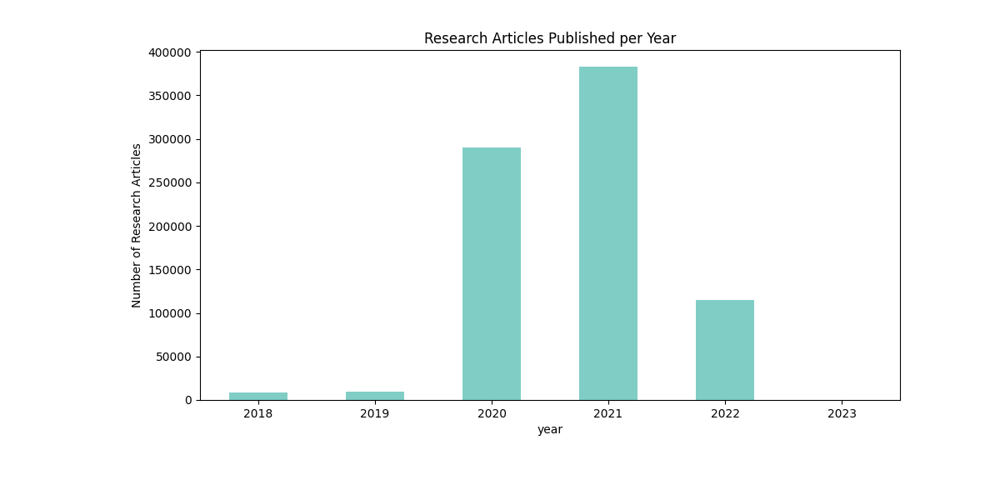

In [55]:
year_data.toPandas().plot(kind='bar', x='year', y='count',
                           color='#80CDC6', figsize=(12, 6))
plt.xlabel('year')
plt.ylabel('Number of Research Articles')
plt.title('Research Articles Published per Year')
plt.legend().remove()
plt.xticks(rotation=0)
plt.subplots_adjust(left=0.2, right=0.9, top=0.9, bottom=0.2)
%matplot plt

<center><small><b>Figure 2.</b> Research Articles Published per Year </small></center>

Figure 2 shows that in 2018 and 2019, there were approximately 17,858 documents combined. This number is significantly lower compared to the volume of research articles in 2020, 2021, and 2022. <b style='color:#073C84'>The increase in research articles is likely due to the COVID-19 pandemic, which surfaced for the first time around December 2019</b> (Yale Medicine, n.d.). Consequently, research on COVID-19 began to surge in 2020 and continued to grow in 2021.

Additionally, <b style="color:#64928E">there were already reports about the growing risk of the coronavirus in Wuhan in 2018 (Rogin, 2021), but these were seen as emerging news, resulting in fewer research articles at that time.</b> The number of articles slightly increased in 2019, as COVID-19 was documented towards the end of that year (Macusi, et al., 2021). In 2022, the number of research articles on COVID-19 remained relatively high, likely due to the emergence of the Omicron variant in November 2021, which peaked around January 2022 (World Health Organization (WHO), 2022).

<div id="docs-per-mth" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Document Counts per Month<br>(2018-2023)</h3></center>
</div> 

In [ ]:
month_data = (data
                  .select('year', 'month')
                  .select(
                      F.to_timestamp(
                          F.concat(
                              F.col("year"), 
                              F.lit("-"), 
                              F.format_string(
                                  "%02d", 
                                  F.col("month")), 
                              F.lit("-01")),
                          "yyyy-MM-dd"
                      ).alias("month"))
                  .groupby('month')
                  .count()
                  .sort('month')
                 )

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

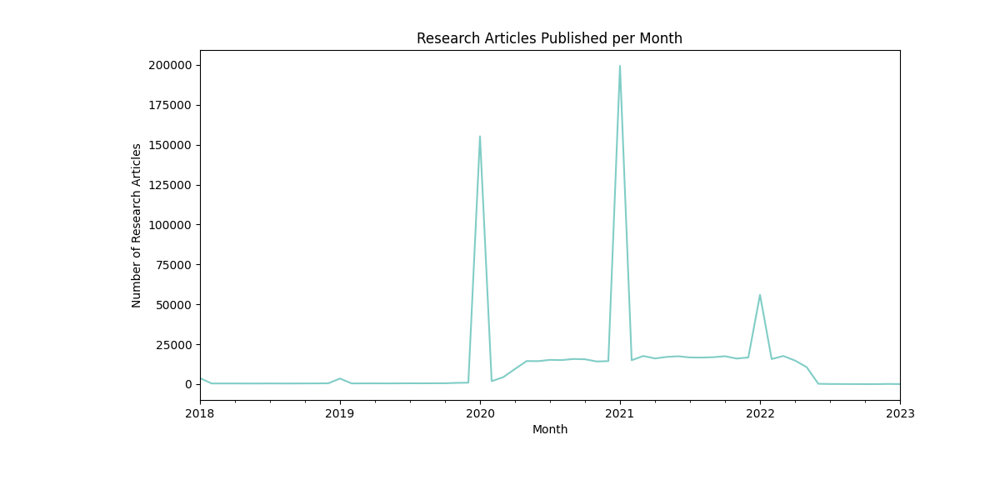

In [65]:
month_data.toPandas().plot(kind='line', x='month', y='count',
                           color='#80CDC6', figsize=(12, 6))
plt.xlabel('Month')
plt.ylabel('Number of Research Articles')
plt.title('Research Articles Published per Month')
plt.legend().remove()
plt.subplots_adjust(left=0.2, right=0.9, top=0.9, bottom=0.2)
%matplot plt

<center><small><b>Figure 3. </b> Research Articles Published per Month </small></center>

Examining the trend in Figure 3, <b style='color:#073C84'>it can be presumed that the spikes in research publications from November to January each year may not be due to the COVID-19 pandemic, but rather a result of the academic research publication cycle</b>. Hypothetically, this spike may be attributed to two main reasons: (1) researchers rushing to get their papers published before the holidays, or (2) researchers publishing their backlog of research as soon as they return from the holidays.

It is quite noticeable that COVID-19 research began to increase in late 2020 and plateaued around the first and second quarters of 2021. The number of studies stabilized until approximately the second quarter of 2022, after which there was a sharp decline towards the end of 2022. <b style="color:#64928E">This decline may be due to a reduction in the collection of new research or a shift in focus, as COVID-19 became less disruptive to everyday life compared to earlier stages of the pandemic</b> (Rio & Malani, 2022).

<div id="wc-per-year" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Yearly Word Clouds of Research Titles</h3></center>
</div> 

In [3]:
def get_counts(year1, year2):
    cloud_words = (data
                   .filter((F.col('year') == year1)
                           | (F.col('year') == year2))
                   .select(
                       F.explode(
                           F.split(
                               F.lower(
                                   F.regexp_replace(
                                       "title", 
                                       "[^a-zA-Z\\s]", 
                                       "")), 
                               "\\s+"))
                       .alias("word")
                   )
                  )
                   
    filtered_words = cloud_words.filter(
        (F.col("word") != "") 
        & (~F.col("word").isin(stopwords_list))
    )
    
    word_counts = (filtered_words
                   .groupBy("word")
                   .count())
    word_counts_pd = word_counts.toPandas()
    wordcloud = (WordCloud(width=800, height=400, 
                       background_color='white')
             .generate_from_frequencies(
                 dict(zip(word_counts_pd['word'], 
                          word_counts_pd['count'])))
            )

    plt.figure(figsize=(10, 5), dpi=250)
    plt.title('Word Cloud for {}-{}'.format(year1, year2))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")

<div id="wc-1819" style="background-color:#2b2b2b; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Word Cloud in Pre-COVID (2018-2019)</h4></center>
</div> 

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

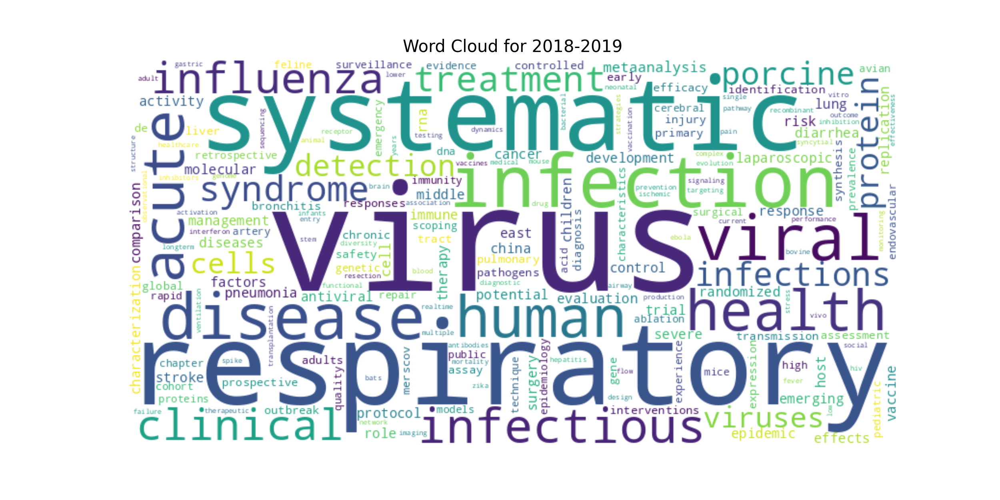

In [67]:
# Pre-Covid Years
get_counts(2018, 2019)
%matplot plt

<center><small><b>Figure 4.</b> Word Cloud for 2018-2019 </small></center>

It is notable in Figure 4 that there is no mention of COVID-19 in the word cloud for this period. This aligns with the fact that research on the virus began only after it was documented at the end of 2019. However, despite the absence of explicit mention, <b style="color:#64928E">the word cloud suggests the presence of numerous related studies, particularly regarding the potential impact of COVID-19 on humans</b>, such as respiratory infections, diarrhea, and viral illnesses. Additionally, other viral outbreaks, such as influenza and other infectious diseases, appear to be more highlighted in the research during this period.

<div id="wc-2021" style="background-color:#2b2b2b; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Word Cloud in Early-to-peak COVID (2020-2021)</h4></center>
</div> 

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

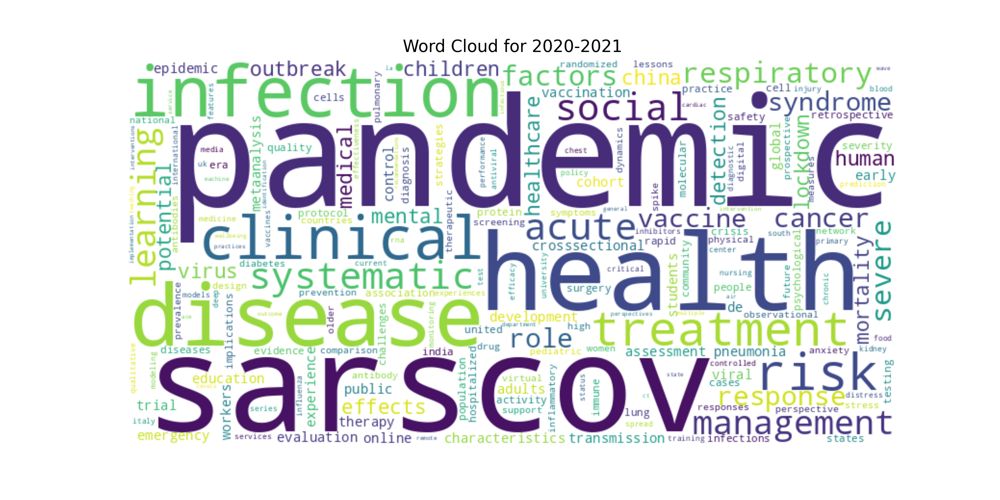

In [68]:
# During Covid Years
get_counts(2020, 2021)
%matplot plt

<center><small><b>Figure 5.</b> Word Cloud for 2020-2021 </small></center>

The prevailing words during the early and peak periods of the COVID-19 (Figure 5) pandemic suggest that <b style='color:#073C84'>research was focused on understanding the virus, its nature, and how to manage it</b>. Words such as clinical, health, factors, severe, and learning point to efforts aimed at understanding the virus. On the other hand, words like treatment, social, and management suggest a focus on how to deal with the pandemic.

It is also noteworthy that, compared to the previous period, this is the first instance where the words pandemic and SARS-CoV were mentioned, indicating a significant shift in research focus towards addressing the challenges posed by the pandemic.

<div id="wc-2223" style="background-color:#2b2b2b; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Word Cloud in Late COVID (2022-2023)</h4></center>
</div> 

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

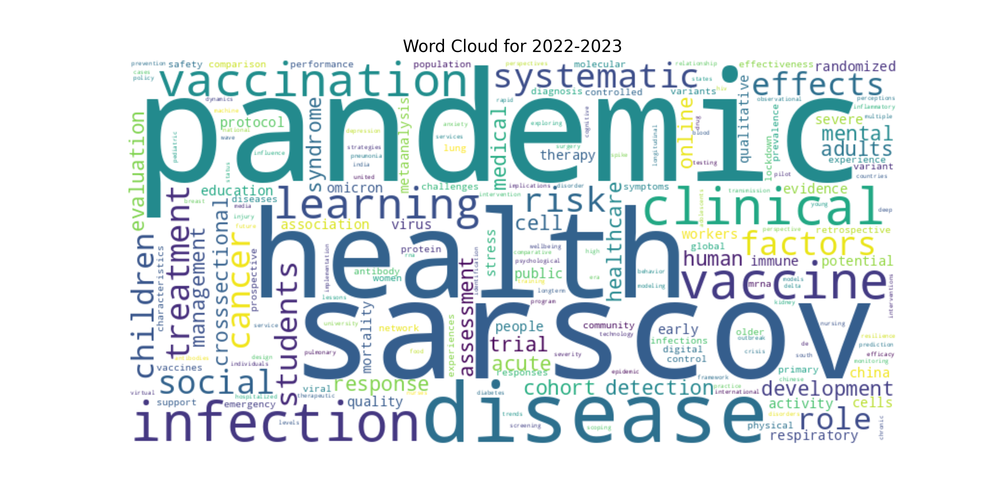

In [69]:
# Late Covid
get_counts(2022, 2023)
%matplot plt

<center><small><b>Figure 6.</b> Word Cloud for 2022-2023 </small></center>

<b style="color:#64928E">In 2022 and 2023 (Figure 6), there are words present in the clouds that also appeared in the early-to-peak pandemic period, suggesting continuity in the content of research</b>. However, the difference lies in the medium-sized words, which focus more on prevention and impact assessment. The presence of words like vaccine, development, trial, and healthcare indicates a focus on prevention, while words like effects, social, mental, children, and adults suggest a focus on assessing the impact of the pandemic.

Word clouds on the research titles offer a general overview of the evolution of medical articles. However, the broad nature of these findings often yields limited actionable insights, as words are not grouped to form meaningful context. To obtain more precise and valuable information, advanced methods must be employed to organize findings and establish clear word associations. Techniques such as topic modeling and natural language processing (NLP) can help in structuring the data more effectively, allowing for a deeper understanding of the relationships between key terms and the overarching themes within the research. These methods can reveal nuanced patterns and trends that simpler visualization tools like word clouds cannot.

<div id="data-preprocessing" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">METHODOLOGY</h1></center>
</div>

The topic modeling technique mentioned earlier is called Latent Dirichlet Allocation (LDA). LDA is popular for its ability to easily extract a specified number of themes from text. To apply LDA, several steps must be followed:

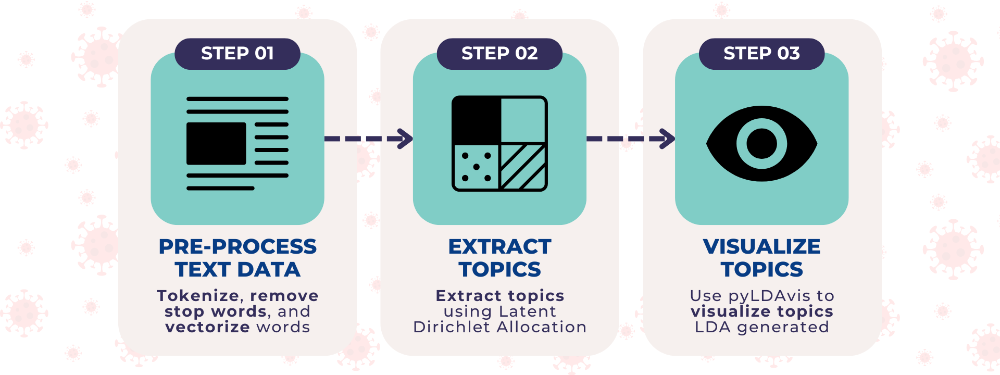

<center><small><b>Figure 7.</b> Methodology Pipeline </small></center>

Figure 7 highlights the process of preparing text data for LDA by converting it into a numerical format. Once pre-processed, LDA can analyze the documents, categorizing them into topics based on assigned probabilities. The process does not end there; visualizing these topics using pyLDAvis aids in clearly identifying and presenting the evolution of topics over time, providing a synthesis of yearly topic trends.

<div id="data-sources-description" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Data Preprocessing</h3></center>
</div> 

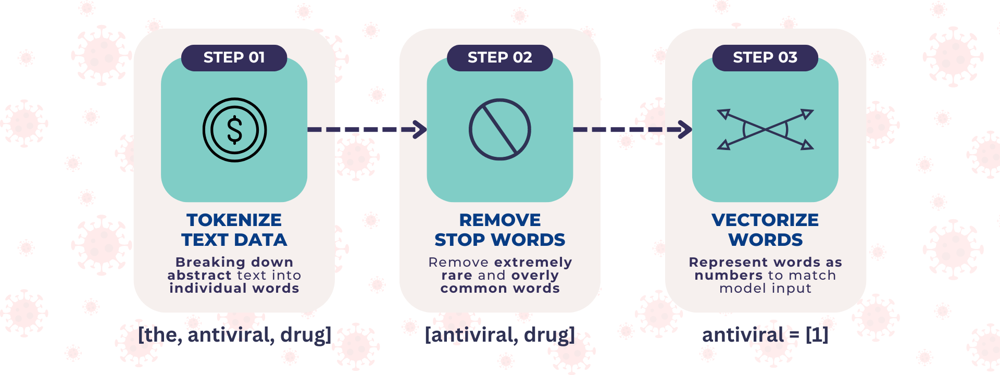

<center><small><b>Figure 8.</b> Data Preprocessing Steps </small></center>

Figure 8 shows the preprocessing steps implemented for this study:

1. <b style='color:#073C84'>Tokenize the abstracts:</b>
Break down each abstract into individual words or tokens. This step is crucial for converting the text into a format that can be analyzed by machine learning algorithms. It involves splitting the text based on spaces and punctuation.

2. <b style='color:#073C84'>Remove the stopwords:</b>
Filter out common words (stopwords) that are frequently used in the language but do not carry significant meaning, such as "and", "the", "is", etc. Removing these words helps focus on the more meaningful words in the abstracts. The list of stopwords also included research-specific words, e.g., 'database', 'studies', 'conducted'.

3. <b style='color:#073C84'>Count vectorization:</b>
Convert the list of tokens (words) into a vector of counts. This process involves creating a dictionary of words from the corpus and counting how many times each word appears in each document. The result is a numerical representation of the text where each word is represented by its frequency.

In [ ]:
data = (spark
        .read
        .parquet('s3://bdcc-project/parquet/', inferSchema=True)
       ).cache()

In [ ]:
# Load the list of stopwords
file_path = "s3://bdcc-project/e-CZ3Y1426IPDIC892RCZED1NOH/bdcc-stopwords.txt"
stopwords_rdd = spark.sparkContext.textFile(file_path)
filtered_stopwords_rdd = stopwords_rdd.filter(lambda line: 
                                              line.strip())
stopwords_list = filtered_stopwords_rdd.collect()

In [19]:
def preprocess_text(df, year=2018, stopwords_list=stopwords_list,
                    minDF=0.01, maxDF=0.9):
    """
    Preprocess the text data by tokenizing, removing stopwords, and
    vectorizing the abstracts.

    Parameters
    ----------
    df : pyspark.sql.dataframe.DataFrame
        The input DataFrame containing the text data.
    year : int, optional
        The year to filter the DataFrame on. Default is 2018. For 2022, it
        includes data from 2023 as well.
    stopwords_list : list
        List of stopwords to remove from the text.
    minDF : float, optional
        The minimum number of documents a term must appear in. Default is 0.01.
    maxDF : float, optional
        The maximum number of documents a term can appear in. Default is 0.9.

    Returns
    -------
    tuple
        A tuple containing the preprocessed DataFrame and the CountVectorizer
        model used for vectorization.
        - data_preprocessed : pyspark.sql.dataframe.DataFrame
            The DataFrame after applying tokenization, stopwords removal, and
            vectorization.
        - cv_model : pyspark.ml.feature.CountVectorizerModel
            The CountVectorizer model fitted to the data.

    """
    # Combine 2022 and 2023
    if year == 2022:
        data = df.filter((F.col('year') == 2022) | 
                         (F.col('year') == 2023)
                        )
    else:
        data = df.filter(F.col('year') == year)
    
    # Tokenize the text
    tokenizer = Tokenizer(inputCol="abstract", outputCol="words")

    # Remove stopwords
    stopwords_remover = StopWordsRemover(inputCol="words",
                                         outputCol="filtered_tokens",
                                         stopWords=stopwords_list)
    # Compute Term Frequency using CountVectorizer
    cv = CountVectorizer(inputCol="filtered_tokens",
                         outputCol="features",
                         minDF=minDF, maxDF=maxDF)
    
    # Build the pipeline
    pipeline = Pipeline(stages=[tokenizer, stopwords_remover, cv,])
    
    # Fit the pipeline to the training data
    preprocessing_model = pipeline.fit(data)
    cv_model = preprocessing_model.stages[2]
    data_preprocessed = preprocessing_model.transform(data)
    
    return data_preprocessed, cv_model

In [ ]:
# Preprocessing the abstract of each year
# 2018
df_2018, cv_2018 = preprocess_text(data, year=2018, 
                                   stopwords_list=stopwords_list,
                                   minDF=0.01, 
                                   maxDF=0.9)
df_2018.cache()

# 2019
df_2019, cv_2019 = preprocess_text(data, year=2019, 
                                   stopwords_list=stopwords_list,
                                   minDF=0.01,
                                   maxDF=0.9)
df_2019.cache()

# 2020
df_2020, cv_2020 = preprocess_text(data, year=2020, 
                                   stopwords_list=stopwords_list,
                                   minDF=0.01, 
                                   maxDF=0.9)
df_2020.cache()

# 2021
df_2021, cv_2021 = preprocess_text(data, year=2021, 
                                   stopwords_list=stopwords_list,
                                   minDF=0.01,
                                   maxDF=0.9)
df_2021.cache()

# 2022
df_2022, cv_2022 = preprocess_text(data, year=2022, 
                                   stopwords_list=stopwords_list,
                                   minDF=0.01,
                                   maxDF=0.9)
df_2022.cache()

In the end, the preprocessed dataset in each year looks like this:

In [13]:
df_2020.limit(3).show(vertical=True)

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

-RECORD 0-------------------------------
 title           | "case of ""relaps... 
 abstract        | clinical outcomes... 
 journal         | nephrology (carlton) 
 language        | en                   
 year            | 2020                 
 month           | 1                    
 words           | [clinical, outcom... 
 filtered_tokens | [clinical, vary, ... 
 features        | (1413,[1,3,4,6,9,... 
-RECORD 1-------------------------------
 title           | ''determining hos... 
 abstract        | objective: in thi... 
 journal         | j. med. virol        
 language        | en                   
 year            | 2020                 
 month           | 1                    
 words           | [objective:, in, ... 
 filtered_tokens | [objective:, stud... 
 features        | (1413,[1,3,4,5,7,... 
-RECORD 2-------------------------------
 title           | 'disinformation o... 
 abstract        | from the overview... 
 journal         | NULL                 
 language       

<center><small><b>Table 3.</b> Preprocessed Dataset </small></center>

<div id="topic-modeling" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Topic Modeling Using Latent Dirichlet Allocation</h3></center>
</div> 

<div id="tm-lda-define" style="background-color:#2b2b2b; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">What is Topic Modeling?<br>What is Latent Dirichlet Allocation?</h4></center>
</div> 

In the fields of statistics and natural language processing, topic models are statistical methods designed to identify the abstract topics present within a collection of documents. Topic modeling serves as a key text-mining technique for uncovering the underlying semantic structures in textual content. The core idea is that specific words will occur wih varying frequencies depending on the topic of the document: words like "antiviral" and "drug" are common in documents about vaccine development, while "strain" and "coronavirus" frequently appear in research articles about new variants of the coronavirus.

It must be emphasized that the topics will only emerge during the topic modeling process, and the goal of topic modeling techniques is to help unravel these topics. One such technique is <b style='color:#073C84'>Latent Dirichlet Allocation (LDA)</b>.

Figure 9 shows the inner workings of LDA for a set of documents with three topics. LDA implements a geometric approach in finding out the underlying themes of the dataset. Since we have three topics, we can visualize them as a triangle, wherein each corner corresponds to a topic. <b style="color:#64928E">LDA represents the documents and topics as a Dirichlet distribution, wherein each document is a distribution of topics.</b> A document will gravitate towards the corner that it belongs to the most based on its overall theme.
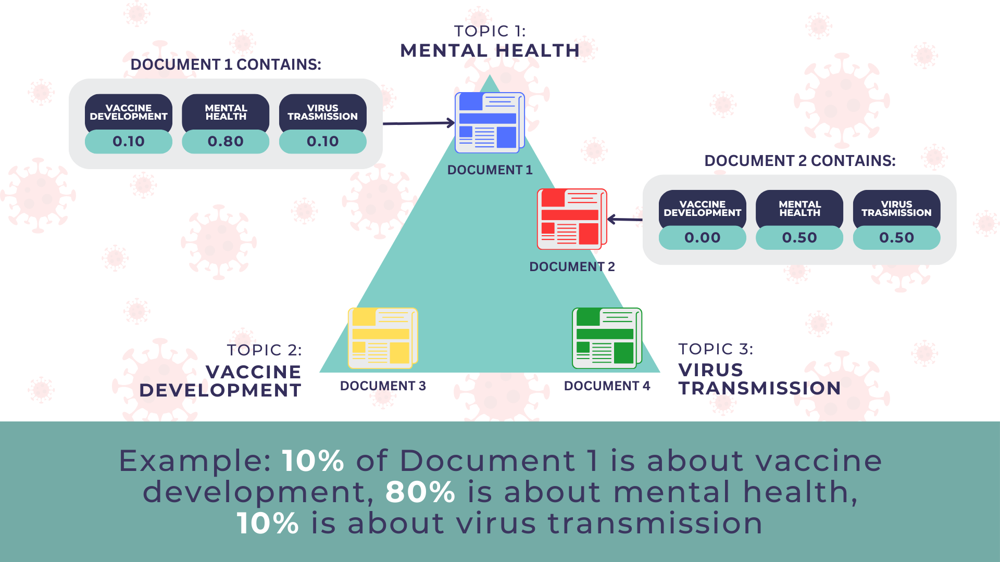

<center><small><b>Figure 9.</b> LDA's geometric approach in identifying topics </small></center>

<br>
But since these topics are hidden (latent), LDA uses the tokens (words) in the documents instead to form the topics. Again, LDA models the topics and words as a Dirichlet distribution, wherein each topic is a distribution of words. LDA does this in such a way that it identifies the most important words in each topic (Figure 10), so that readers (us) can just infer what a topic is all about using its keywords.<br>
<br>

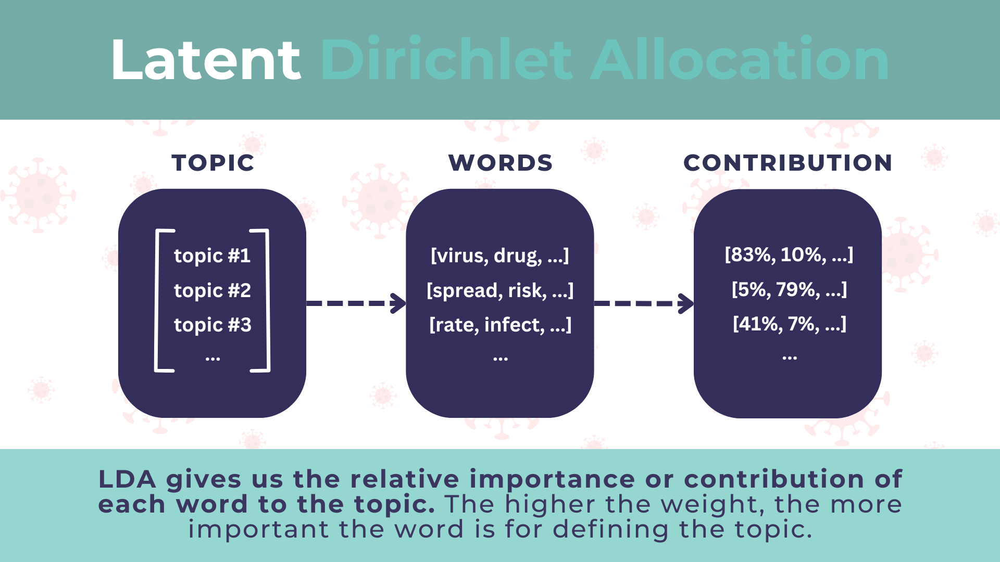

<center><small><b>Figure 10.</b> LDA uses the tokens (words) of the document to identify topics. </small></center>

<div id="lda-implem" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Implementing LDA on the CORD-19 Dataset</h3></center>
</div> 

<b style="color:#64928E">A function is used to perform Latent Dirichlet Allocation (LDA) on the preprocessed data, describe the topics discovered, and assign the most dominant topic to each document in the dataset</b>. It takes a preprocessed Spark DataFrame, a CountVectorizerModel containing the vocabulary, and optional parameters like the number of topics, maximum terms per topic, and maximum iterations for LDA. The function trains an LDA model on the preprocessed data, describes the topics by extracting the top keywords for each topic, transforms the dataset with the trained LDA model, and assigns the dominant topic to each document. It returns a tuple containing the transformed DataFrame with a `DominantTopic` column, the trained LDA model, and a DataFrame describing the topics with their corresponding keywords.

As an initial exploration, this study included 50 topics, which was based on the distribution of topics mentioned by the authors (Wang et al., 2020) as shown in Table 4. 

| Subfield             | Count | % of corpus |
|----------------------|-------|-------------|
| Virology             | 20116 | 42.3%       |
| Immunology           | 9875  | 20.7%       |
| Molecular biology    | 6040  | 12.7%       |
| Genetics             | 3783  | 8.0%        |
| Intensive care medicine | 3204  | 6.7%     |
| Other                | 4595  | 9.6%        |

<center><small><b>Table 4.</b> Representation of MAG subfields of study in CORD-19.</small></center>

However, <b style="color:#073C84">it is crucial to acknowledge that the dataset may have become more diverse due to subsequent updates</b>, potentially requiring a different number of topics for optimal representation.

In [24]:
def perform_lda(data_preprocessed, cv_model, k=50,
                maxTerms=15, maxIter=100):
    """
    Perform Latent Dirichlet Allocation (LDA) on preprocessed data,
    describe topics, and assign the most dominant topic to each document.

    Parameters
    -----------
    data_preprocessed : DataFrame
        The preprocessed Spark DataFrame that contains a column of features
        used for LDA.
    cv_model : CountVectorizerModel
        The CountVectorizerModel obtained from preprocessing that contains the
        vocabulary.
    k : int, optional
        The number of topics to find (default is 50).
    maxTerms : int, optional
        The maximum number of terms to collect for each topic (default is 15).
    maxIter : int, optional
        The maximum number of iterations to use for LDA (default is 100).

    Returns
    --------
    tuple
        A tuple containing the transformed DataFrame with a 'DominantTopic'
        column, the trained LDA model,
        and a DataFrame describing topics with their corresponding keywords.
    """
    lda = LDA(k=k, maxIter=maxIter, optimizer='online')
    lda_model = lda.fit(data_preprocessed)

    # Describe topics
    topics = lda_model.describeTopics(maxTermsPerTopic=maxTerms)
    
    # Transform the dataset
    transformed_df = lda_model.transform(data_preprocessed)

    # Define UDF
    argmax_udf = F.udf(lambda x: int(np.argmax(x)), IntegerType())
    transformed_df = (transformed_df
                      .withColumn('DominantTopic',
                                  argmax_udf('topicDistribution')))

    # Retrieve the vocabulary from CountVectorizer model
    vocabulary = cv_model.vocabulary

    # Function to map topic indices to words
    def topics_to_words(topics_df, vocabulary):
        topics_words = (topics_df.rdd.map(lambda row: [vocabulary[idx] 
                                                      for idx in 
                                                      row.termIndices])
                        .collect())
        return topics_words

    # Print the keywords for each topic
    keywords = topics_to_words(topics, vocabulary)
    for idx, topic_keywords in enumerate(keywords):
        print(f"Topic {idx}: {topic_keywords}")

    # Return the transformed dataframe and keywords
    return transformed_df, lda_model, topics

The following presents the top 15 keywords for the identified topics in each year:

<div id="lda-implem" style="background-color:#2b2b2b ; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Topics and Keywords in 2018</h4></center>
</div> 

In [20]:
lda_2018, lda_model_2018, topics_2018 = perform_lda(df_2018, cv_2018,
                                                    k=50)

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Topic 0: ['lung', 'pulmonary', 'injury', 'acute', 'chronic', 'respiratory', 'diagnostic', 'transplantation', 'diagnosis', 'macrophages', 'organ', 'increased', 'distress', 'compared', 'clinical']
Topic 1: ['threshold', 'dynamics', 'epidemics', 'insight', 'epidemic', 'parameters', 'established', 'estimates', 'host', 'time.', 'occur', 'provide', 'influence', 'demonstrate', 'rate']
Topic 2: ['generation', 'created', 'rsv', 'specific', 'sequences', 'content', 'genome', 'genomic', 'viral', 'random', 'infection.', 'main', 'proportion', 'theoretical', 'sequence']
Topic 3: ['animals', 'elevated', 'organ', 'pigs', 'determine', 'specific', 'animal', 'models.', 'maintained', 'common', 'cerebral', 'remaining', 'biological', 'sought', 'study.']
Topic 4: ['infants', 'risk', 'higher', 'oxygen', 'gain', 'circulation', 'compared', 'considered', 'quality', 'implementation', 'bias', 'controls', 'early', 'protocol', 'infectious']
Topic 5: ['viral', 'rna', 'virus', 'host', 'viruses', 'protein', 'replication

In [ ]:
df_2018.unpersist()
lda_2018.cache()

<div id="lda-implem" style="background-color:#2b2b2b ; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Topics and Keywords in 2019</h4></center>
</div> 

In [22]:
lda_2019, lda_model_2019, topics_2019 = perform_lda(df_2019, cv_model=cv_2019,
                                                    k=50)

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Topic 0: ['diagnostic', 'detection', 'clinical', 'performance', 'sensitivity', 'developed', 'assay', 'diagnosis', 'specificity', 'testing', 'high', 'test', 'dna', 'accuracy', 'compared']
Topic 1: ['icu', 'ii', 'antimicrobial', 'intensive', 'pneumonia', 'unit', 'admission', 'mortality', 'failure', 'severe', 'adult', 'materials', 'vaccine', 'presenting', 'pathogen']
Topic 2: ['surveillance', 'liver', 'include', 'detect', 'conventional', 'disease', 'protective', 'human', 'alternative', 'oral', 'severity', 'number', 'strategies', 'produce', 'data,']
Topic 3: ['cells', 'sites', 'highest', 'elements', 'higher', 'biological', 'genomic', 'chemical', 'control,', 'materials', 'improving', 'events.', 'treating', 'perform', 'patients,']
Topic 4: ['ibv', 'avian', 'infectious', 'bronchitis', 'poultry', 'virus', 'gene', 'genomic', 'single', 'region', 'temporal', 'genetic', 'reverse', 'industry', 'sites']
Topic 5: ['air', 'isolation', 'ventilation', 'source', 'global', 'environment', 'particles', 'lev

In [ ]:
df_2019.unpersist()
lda_2019.cache()

<div id="lda-implem" style="background-color:#2b2b2b ; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Topics and Keywords in 2020</h4></center>
</div> 

In [24]:
lda_2020, lda_model_2020, topics_2020 = perform_lda(df_2020, cv_model=cv_2020,
                                                    k=50)

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Topic 0: ['score', 'severity', 'clinical', 'predictive', 'disease', 'risk', 'predict', 'regression', 'curve', 'prognostic', 'prediction', 'scores', 'predicting', 'ct', 'independent']
Topic 1: ['plasma', 'chinese', 'market', 'medicine', 'traditional', 'products', 'financial', 'animal', 'global', 'production', 'human', 'pathogens', 'economy', 'development', 'demand']
Topic 2: ['exposure', 'practice', 'temperature', 'practices', 'risk', 'respondents', 'environmental', 'medical', 'distance', 'high', 'level', 'knowledge,', 'simulation', 'room', 'good']
Topic 3: ['children', 'older', 'adults', 'years', 'young', 'aged', 'younger', 'families', 'years,', 'reported', 'adult', 'years.', 'compared', 'lower', '18']
Topic 4: ['days', '1', '3', '2', '5', '4', '6', '7', 'primary', '10', 'results:', '8', 'methods:', 'outcome', '12']
Topic 5: ['surgery', 'surgical', 'staff', 'medical', 'emergency', 'procedures', 'hospitals', 'pandemic', 'elective', 'results:', 'methods:', 'performed', 'infection', 'depa

In [ ]:
df_2020.unpersist()
lda_2020.cache()

<div id="lda-implem" style="background-color:#2b2b2b ; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Topics and Keywords in 2021</h4></center>
</div> 

In [26]:
lda_2021, lda_model_2021, topics_2021 = perform_lda(df_2021, cv_model=cv_2021,
                                                    k=50)

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Topic 0: ['±', '(mean', 'percentage', '0.001).', 'compared', 'respectively.', '0.001)', 'results:', 'average', 'methods:', 'higher', 'strain', 'visual', 'years,', 'lower']
Topic 1: ['scores', 'quality', 'score', 'results:', 'pain', 'satisfaction', 'methods:', 'scale', 'participants', 'clinic', 'completed', 'questionnaire', 'reported', 'assessment', 'assess']
Topic 2: ['positive', 'symptoms', 'asymptomatic', 'tested', 'testing', 'symptomatic', 'negative', 'symptom', 'cases', 'reaction', 'chain', 'days', 'rt-pcr', 'pcr', 'contact']
Topic 3: ['compared', 'higher', 'lower', 'difference', 'positive', 'differences', 'healthy', 'control', 'correlation', 'controls', 'statistically', 'negative', 'groups.', 'moderate', 'results:']
Topic 4: ['treatment', 'clinical', 'trial', 'therapy', 'efficacy', 'trials', 'intervention', 'randomized', 'primary', 'participants', 'safety', 'control', 'controlled', 'treated', 'outcome']
Topic 5: ['health', 'mental', 'psychological', 'stress', 'pandemic', 'social',

In [ ]:
df_2021.unpersist()
lda_2021.cache()

<div id="lda-implem" style="background-color:#2b2b2b ; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">Topics and Keywords in 2022</h4></center>
</div> 

In [29]:
lda_2022, lda_model_2022, topics_2022 = perform_lda(df_2022, cv_model=cv_2022,
                                                    k=50)

VBox()

FloatProgress(value=0.0, bar_style='info', description='Progress:', layout=Layout(height='25px', width='50%'),…

Topic 0: ['treatment', 'therapy', 'clinical', 'treated', 'oral', 'efficacy', 'months', '3', '6', 'safety', '1', 'treatment.', 'follow-up', '2', 'reduction']
Topic 1: ['symptoms', 'cognitive', 'symptom', 'symptoms.', 'symptoms,', '–', 'depressive', 'long', 'persistent', 'months', 'onset', 'reported', 'neurological', 'mild', 'memory']
Topic 2: ['dose', 'covid‐19', 'adverse', 'events', 'days', 'years', 'severe', '(95%', 'aged', 'pediatric', 'persons', 'adults', 'risk', 'doses', 'reported']
Topic 3: ['95%', 'risk', 'factors', '(or', 'regression', 'higher', 'prevalence', 'logistic', 'health', 'supplementary', 'odds', 'association', 'men', 'ci:', 'years']
Topic 4: ['cell', 'cells', 'expression', 'immune', 'inflammatory', 'increased', 'role', 'levels', 'activation', 'mice', 'cells.', 'human', 'cells,', 'inflammation', 'disease']
Topic 5: ['participants', 'training', 'program', 'intervention', 'completed', 'results:', 'methods:', 'online', 'supplementary', 'feasibility', 'background:', 'progra

In [ ]:
df_2022.unpersist()
lda_2022.cache()

<div id="pyldavis" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">Visualizing the Topics Using pyLDAvis</h3></center>
</div> 

As you might have noticed, presenting topics and their corresponding keywords in a list format can be visually unappealing. Lucky for us, we have the `pyLDAvis` library at our disposal, which offers an interactive visualization for topic models. <b style='color:#073C84'><code style='color:#073C84'>pyLDAvis</code> enables us to clearly visualize the dominant and emerging topics, as well as the most significant words associated with each topic in an intuitive and engaging way</b>.

At this point, we are going to prepare the data for visualizing using `pyLDAvis`.

Two functions will be used for this purpose: `format_data_to_pyldavis` and `filter_bad_docs`.
- **`format_data_to_pyldavis`**: This function takes a Spark DataFrame containing filtered text data, a CountVectorizerModel, a transformed DataFrame with topic distributions, and a trained LDA model. <b style='color:#64928E'>It prepares the data in a dictionary format that can be used by the pyLDAvis library for visualizing the topic models</b>. The dictionary includes topic-term distributions from the LDA model, document-topic distributions, document lengths, vocabulary terms, and term frequencies. This function is useful for visualizing and exploring the trained LDA topic model.
<br><br>
- **`filter_bad_docs`**: This function takes the dictionary prepared by `format_data_to_pyldavis` and filters out documents with invalid or problematic topic distributions. <b style='color:#073C84'>Specifically, it removes documents where the topic distribution does not sum to 1, contains NaN values, or has a sum of zero (indicating no topics were assigned)</b>. The function modifies the 'doc_topic_dists' and 'doc_lengths' keys in the input dictionary, removing the problematic documents and their corresponding lengths. This function helps ensure that the data used for visualization with pyLDAvis is clean and does not include documents with invalid or inconsistent topic distributions.

Then an instance of the S3FileSystem from the `s3fs` library is created, which allows for interacting with Amazon S3 buckets. This requires providing authentication credentials, including an AWS access key and secret access key. The visualization data for the prepared LDA data is then generated using the display function from the `pyLDAvis` library. This resulting visualization data is written to a specified S3 bucket as a pickle file by calling the `dump` function from the pickle library and using the open method from the S3FileSystem instance. The `open` method then creates a file-like object in the S3 bucket, with the 'wb' mode indicating that the file should be opened for writing binary data.

Here's a sample code for preparing the data for `pyLDAvis`:
```python
# Preparating the data for 2018
lda_data = format_data_to_pyldavis(df_2018, cv_2018, lda_2018, lda_model_2018)
filter_bad_docs(lda_data)
py_lda_prepared_data = pyLDAvis.prepare(**lda_data)

fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
                       secret='<insert-secret-access-key>',)

dump(pyLDAvis.display(py_lda_prepared_data), 
     fs.open(f's3://bdcc-project/display_lda_2018.pkl', 'wb'))
```

**Reading the pickled files**

For convenience, the pickled files have been included along with this notebook. But one could still display the topics directly from an S3 bucket using this code:
```python
# Read with python kernel
import pickle
import s3fs

fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
                       secret='<insert-secret-access-key>',)
file_2018 = fs.open("s3://bdcc-project/display_lda_2018.pkl",'rb')
topics_2018 = pickle.load(file_2018)
topics_2018
```

<b style='color:#073C84'>Note: If you're initially using PySpark during implementation, you must shift to a Python 3 kernel (ipykernel) when displaying the <code style='color:#2F3254'>pyLDAvis</code> visualizations in each year.</b>

In [9]:
def format_data_to_pyldavis(df_filtered, count_vectorizer, transformed, lda_model):
    """
    Format Spark DataFrame data for visualization with pyLDAvis.

    Parameters
    -----------
    df_filtered : DataFrame
        The Spark DataFrame with filtered data containing a column of filtered
        tokens.
    count_vectorizer : CountVectorizerModel
        The CountVectorizerModel used to transform the text data.
    transformed : DataFrame
        The DataFrame resulting from the LDA transformation, containing the
        topic distribution for each document.
    lda_model : LDA Model
        The trained LDA model from Spark ML.

    Returns
    --------
    dict
        A dictionary formatted for pyLDAvis, containing:
        - topic_term_dists: numpy array of topic-term distributions.
        - doc_topic_dists: numpy array of document-topic distributions.
        - doc_lengths: list of lengths of each document.
        - vocab: list of vocabulary terms used in the model.
        - term_frequency: list of term frequencies for each vocabulary term.
    """
    # Explode the filtered tokens and count occurrences of each word
    xxx = (df_filtered
           .select((F.explode(df_filtered.filtered_tokens)).alias("words"))
           .groupby("words")
           .count()
          )
    
    # Create a dictionary of word counts
    word_counts = {r['words']: r['count'] for r in xxx.collect()}
    
    # Generate a list of frequencies using the vocabulary of CountVectorizer
    word_counts = [word_counts[w] for w in count_vectorizer.vocabulary]

    # Prepare data for pyLDAvis:
    # topic_term_dists: topic-term distributions from LDA model
    data = {
        'topic_term_dists': np.array(lda_model.topicsMatrix().toArray()).T,
        
        # doc_topic_dists: document-topic distributions
        'doc_topic_dists': np.array([x.toArray() 
                                     for x in (transformed
                                               .select(["topicDistribution"])
                                               .toPandas()['topicDistribution']
                                              )
                                    ]
                                   ),
        
        # doc_lengths: count of tokens per document
        'doc_lengths': [r[0]
                        for r in (df_filtered
                                  .select(F.size(df_filtered.filtered_tokens))
                                  .collect()
                                 )
                       ],
        
        # vocab: vocabulary from the CountVectorizer
        'vocab': count_vectorizer.vocabulary,
        
        # term_frequency: frequency of each term in the vocabulary
        'term_frequency': word_counts
    }

    return data


def filter_bad_docs(data):
    """
    Filter out documents with invalid topic distributions from the data
    prepared for pyLDAvis.

    Parameters
    -----------
    data : dict
        The dictionary containing data for pyLDAvis, including document-topic
        distributions and document lengths.

    Modifies
    ---------
    data : dict
        Updates the 'doc_topic_dists' and 'doc_lengths' in the input
        dictionary by removing documents that:
        - Do not sum to one in their topic distribution.
        - Contain any NaN values in their topic distribution.
        - Have a sum of zero in their topic distribution, indicating no topics
        assigned.
    """
    bad = 0 # Counter for documents that do not meet the criteria
    doc_topic_dists_filtered = [] # Filtered document-topic distributions
    doc_lengths_filtered = [] # For filtered document lengths
    
    # Iterate thru each document's topic distribution and corresponding length
    for x, y in zip(data['doc_topic_dists'], data['doc_lengths']):
        if np.sum(x) == 0: 
            bad += 1 # Increment bad counter if no topics are assigned
        elif np.sum(x) != 1:
            bad += 1 # Add bad counter if sum of topic distributions is not 1
        elif np.isnan(x).any():
            bad += 1 # Increment bad counter if there are NaN values
        else:
            # Add valid topic distribution to filtered list
            doc_topic_dists_filtered.append(x) 

            # Add corresponding document length to filtered list
            doc_lengths_filtered.append(y) 
    
    # Update the data dictionary with the filtered lists
    data['doc_topic_dists'] = doc_topic_dists_filtered
    data['doc_lengths'] = doc_lengths_filtered


In [ ]:
# Preparating the data for 2018
lda_data = format_data_to_pyldavis(df_2018, cv_2018, lda_2018, lda_model_2018)
filter_bad_docs(lda_data)
py_lda_prepared_data = pyLDAvis.prepare(**lda_data)

fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
                       secret='<insert-secret-key>',)

dump(pyLDAvis.display(py_lda_prepared_data), 
     fs.open(f's3://bdcc-project/display_lda_2018.pkl', 'wb'))

In [ ]:
# Preparating the data for 2019
lda_data = format_data_to_pyldavis(df_2019, cv_2019, lda_2019, lda_model_2019)
filter_bad_docs(lda_data)
py_lda_prepared_data = pyLDAvis.prepare(**lda_data)

fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
                       secret='<insert-secret-key>',)
dump(pyLDAvis.display(py_lda_prepared_data),
     fs.open(f's3://bdcc-project/display_lda_2019.pkl', 'wb'))

In [ ]:
# Preparating the data for 2020
lda_data = format_data_to_pyldavis(df_2020, cv_2020, lda_2020, lda_model_2020)
filter_bad_docs(lda_data)
py_lda_prepared_data = pyLDAvis.prepare(**lda_data)

fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
                       secret='<insert-secret-key>',)
dump(pyLDAvis.display(py_lda_prepared_data),
     fs.open(f's3://bdcc-project/display_lda_2020.pkl', 'wb'))

In [ ]:
# Preparating the data for 2021
lda_data = format_data_to_pyldavis(df_2021, cv_2021, lda_2021, lda_model_2021)
filter_bad_docs(lda_data)
py_lda_prepared_data = pyLDAvis.prepare(**lda_data)

fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
                       secret='<insert-secret-key>',)

dump(pyLDAvis.display(py_lda_prepared_data),
     fs.open(f's3://bdcc-project/display_lda_2021.pkl', 'wb'))

In [ ]:
# Preparating the data for 2022
lda_data = format_data_to_pyldavis(df_2022, cv_2022, lda_2022, lda_model_2022)
filter_bad_docs(lda_data)
py_lda_prepared_data = pyLDAvis.prepare(**lda_data)

fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
                       secret='<insert-secret-key>',)

dump(pyLDAvis.display(py_lda_prepared_data),
     fs.open(f's3://bdcc-project/display_lda_2022.pkl', 'wb'))

<div id="lda-implem" style="background-color:#2b2b2b ; padding: 10px 0;">
    <center><h4 style="color:white; font-weight:bold">A Brief Introduction to pyLDAvis</h4></center>
</div> 

Figure 11 shows a sample output of pyLDAvis. There are three important things to take note:
1. <b style='color:#073C84'>Intertopic Distance Map (via multidimensional scaling)</b>: This map displays topics as bubbles in two-dimensional space, where the proximity between any two topics suggests how similar they are. <b style='color:#64928E'>Each bubble represents a topic and its size indicates the marginal topic distribution—the share of the overall corpus that the topic occupies.</b>
<br><br>
2. <b style='color:#073C84'>Top-30 Most Relevant Terms:</b> This displays the terms that are most relevant to a selected topic. The terms are ranked based on a “relevance metric” that can be adjusted using the lambda ($\lambda$) value.
    - <b style='color:#64928E'>Relevance Metric ($\lambda$)</b>: This balances the raw frequency of a term in a topic (blue bars) and the term’s lift (red bars). **Lift measures how much more a term is used in a specific topic compared to its general usage across the entire collection of documents**. The ($\lambda$) slider allows us to adjust the emphasis between the term’s frequency within the topic and its distinctiveness to that topic.
    -  <b style='color:#64928E'>$\lambda = 1$</b>: 
       - When $\lambda$ is set to 1, the relevance metric prioritizes the terms purely based on their probability within the topic. This means the terms displayed are those that are most frequent within the specific topic. **The higher a term's probability in a topic, the more it contributes to the character of that topic according to the model**. However, this does not account for how unique these terms are to the topic; they might also be common in other topics or throughout the entire corpus.
    -  <b style='color:#64928E'>$\lambda = 0$</b>: 
        - Setting $\lambda$ to 0 shifts the focus entirely to the term's lift, which compares the term's frequency in a specific topic to its frequency across the entire corpus. This setting filters out common words and highlights terms that are uniquely or distinctively associated with the topic, even if they are not the most frequent terms within that topic. It emphasizes how much more likely a term is to appear in a topic compared to its general frequency across all documents.

<b style='color:#073C84'>In this study, the authors set $\lambda$ at 0.40 to get a more refined context in a particular year by prioritizing the distinctiveness of a term to a certain topic.</b>

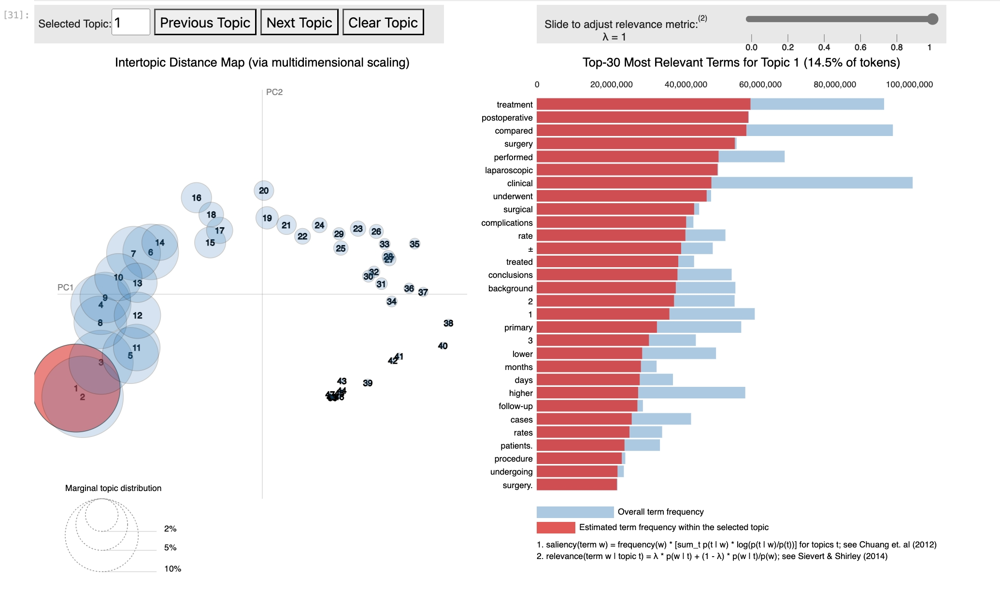

<center><small><b>Figure 11.</b> Sample output of <code>pyLDAvis</code>.</small></center>

<div id="data-preprocessing" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">RESULTS AND DISCUSSION</h1></center>
</div>

<div id="results-summary" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">The Timeline of COVID-19 from 2018 to 2022<br>through Latent Dirichlet Allocation</h3></center>
</div> 

From 2018 to 2022, the trajectory of scientific research evolved significantly in response to global health developments. In 2018, before the onset of the COVID-19 pandemic, research predominantly focused on general medical topics like surgery and immunology, although there was already some attention on coronaviruses, such as MERS-CoV. This interest intensified in 2019, particularly towards coronaviruses originating from bats, which aligns with the early cases of COVID-19 in December 2019. By 2020, the research community's efforts pivoted to understand and manage COVID-19—examining its spread, the public health responses, and its broader impacts on mental health and education. The following year, 2021, saw a sustained focus on these areas but with an increased emphasis on developing antiviral vaccines and understanding the pandemic's effects on educational systems. Additionally, there was a notable exploration into the use of machine learning in medical imaging to aid COVID-19 diagnosis. By 2022, the research broadened to reflect on the pandemic’s extensive socio-economic, health, and environmental impacts, highlighting the profound influence COVID-19 has had on global scientific discourse and policymaking.

<div id="results-2018" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">2018: Medical research was business-as-usual</h3></center>
</div> 

In [ ]:
# If you're reading from EMR, switch to a Python kernel then run this first
%pip install s3fs

In [12]:
# Read with python kernel
import pickle
# import s3fs

# fs = s3fs.S3FileSystem(anon=False, key='<insert-access-key>',
#                        secret='<insert-secret-key>',)

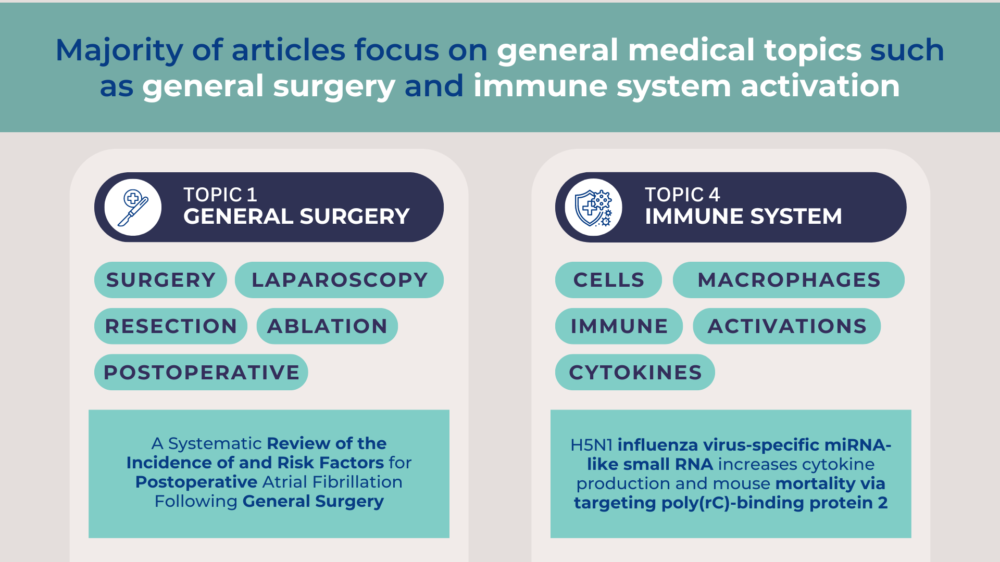

<center><small><b>Figure 12.</b> Majority Topics in 2018</small></center>

<img src="2018-2.png">

<center><small><b>Figure 13.</b> Minority Topics in 2018</small></center>

In [13]:
file_2018 = open("display_lda_2018.pkl",'rb')
topics_2018 = pickle.load(file_2018)
topics_2018

<center><small><b>Figure 14.</b> pyLDAvis for 2018</small></center>

<b style='color:#64928E'>In 2018, the majority of the documents covered general medical topics such as surgery and immunology, which is understandable as the COVID-19 pandemic had not yet emerged</b>. However, this does not imply that coronaviruses were not being discussed at that time. There were research papers published in 2018 that reviewed the impacts of MERS-CoV, a strain belonging to the coronavirus family. This is not surprising, as the first human coronaviruses were identified as early as the 1960s. There were also discussions around new variants of the coronavirus, which could have been utilized for early mobilization and prevention strategies against potential outbreaks.

<b style='color:#073C84'>While general medical topics dominated the discourse in 2018, the existence of papers addressing coronaviruses, specifically MERS-CoV, demonstrates that these viruses were already on the radar of the scientific community, even before the outbreak of the COVID-19 pandemic</b>. These discussions surrounding new coronavirus variants highlight the potential of this model for taking proactive measures and preparedness in the face of emerging viral threats.


<div id="results-2019" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">2019: Rising Focus on Bat-Origin Coronaviruses</h3></center>
</div> 

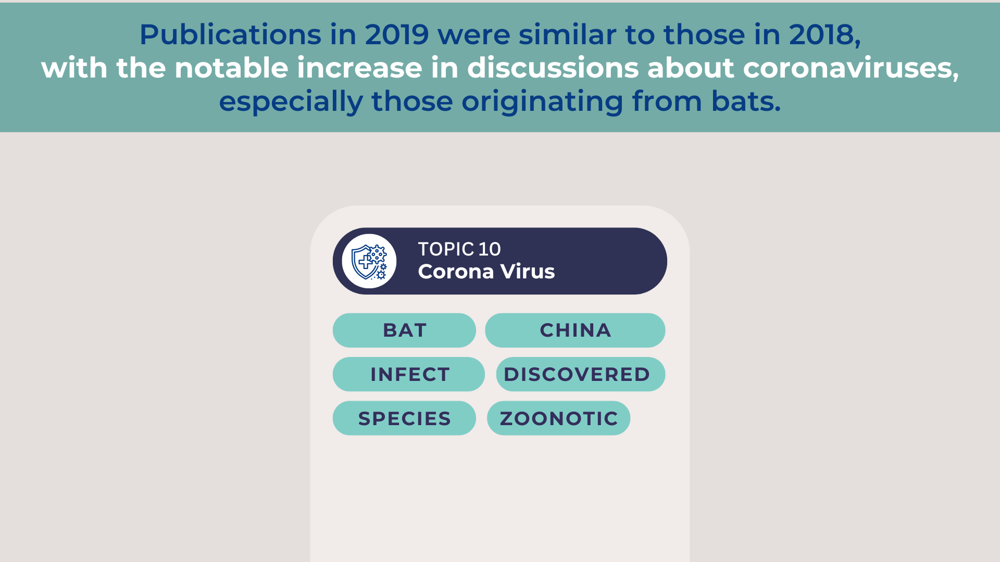

<center><small><b>Figure 15.</b> Topic in 2019</small></center>

In [14]:
file_2019 = open("display_lda_2019.pkl",'rb')
topics_2019 = pickle.load(file_2019)
topics_2019

<center><small><b>Figure 16.</b> pyLDAvis for 2019</small></center>

<b style='color:#64928E'>In 2019, scientific publications generally followed trends from 2018, but there was a significant rise in research focused on coronaviruses originating from bats</b>. This increased attention on bat-origin coronaviruses may also be linked to the emergence of COVID-19 cases in December 2019, which prompted researchers to delve deeper into similar viruses and their implications for global health.

<div id="results-2020" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">2020: Understanding COVID-19</h3></center>
</div> 

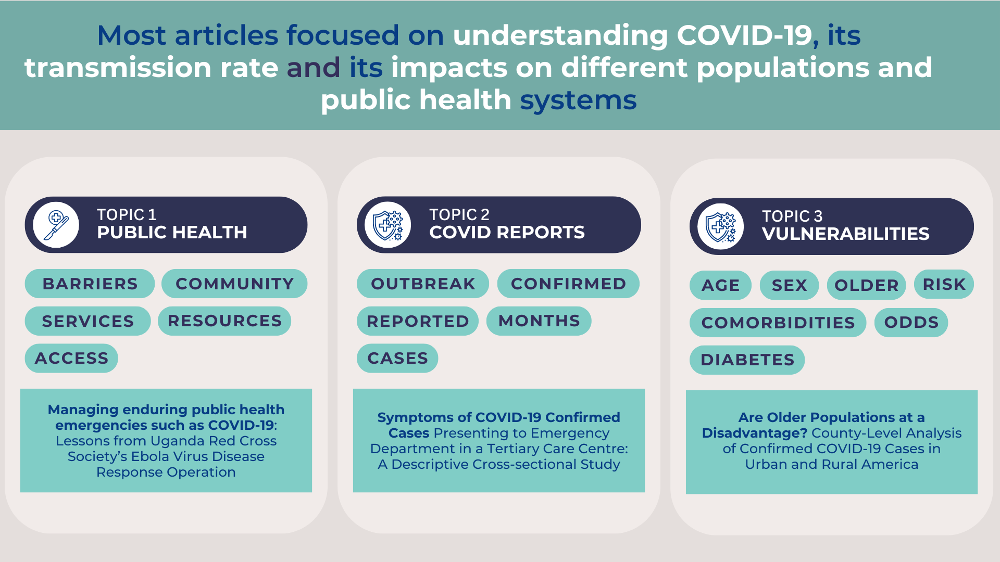

<center><small><b>Figure 17.</b> Top Three Topics in 2020</small></center>

<img src="2020-2.png">

<center><small><b>Figure 18.</b> Minority Topics in 2020</small></center>

In [15]:
file_2020 = open("display_lda_2020.pkl",'rb')
topics_2020 = pickle.load(file_2020)
topics_2020

<center><small><b>Figure 19.</b> pyLDAvis for 2020</small></center>

In 2020, at the height of the pandemic, the focus of research shifted dramatically. <b style='color:#64928E'>Scientists and experts poured their efforts into understanding COVID-19</b>—tracking the spread of cases, assessing the strengths and weaknesses of public health responses, and figuring out who was most vulnerable to the virus. At the same time, there was a growing recognition of the pandemic’s broader effects, especially on mental health and education. People started to really notice and study how the crisis was affecting our well-being and the way we learn, which highlights the deep and diverse impacts of the pandemic.

<div id="results-2021" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">2021: The Search for Vaccines and Adapting to the the New Normal in Education</h3></center>
</div> 

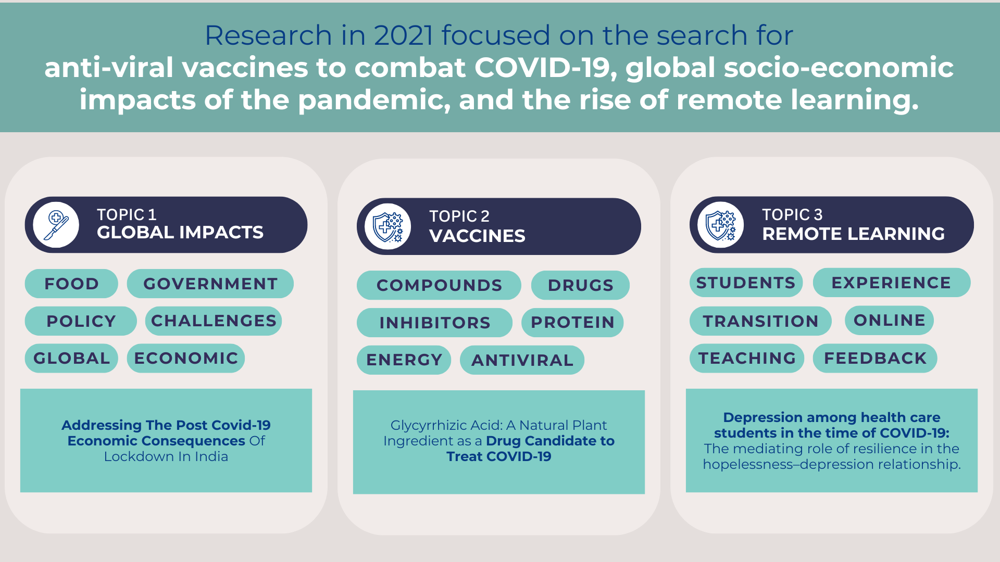

<center><small><b>Figure 19.</b> Top Three Topics in 2021</small></center>

<img src="2021-2.png">

<center><small><b>Figure 20.</b> Machine Learning Topic for COVID-19 in 2021</small></center>

In [16]:
file_2021 = open("display_lda_2021.pkl",'rb')
topics_2021 = pickle.load(file_2021)
topics_2021

<center><small><b>Figure 21.</b> pyLDAvis for 2021</small></center>

In 2021, research efforts echoed those of 2020, but now with a <b style='color:#64928E'>strong emphasis on developing antiviral vaccines to fight COVID-19</b>. At the same time, there was a growing focus on understanding the pandemic's broader effects (Topic 1), particularly its impact on education (Topic 3). As schools adapted to lockdowns by shifting to remote learning, researchers delved into this new normal, exploring the experiences and challenges faced by students and educators navigating this uncharted territory.

Additionally, Topic 15 highlighted emerging themes in the realms of data science and artificial intelligence, specifically in the use of computed tomography (CT). During this period, experts were pioneering the <b style='color:#073C84'>application of machine learning techniques to CT and X-ray images to aid in the diagnosis of COVID-19</b>.

<div id="results-2022" style="background-color:#2F3254 ; padding: 10px 0;">
    <center><h3 style="color:white; font-weight:bold">2022: Grappling with the Aftermath of COVID-19</h3></center>
</div> 

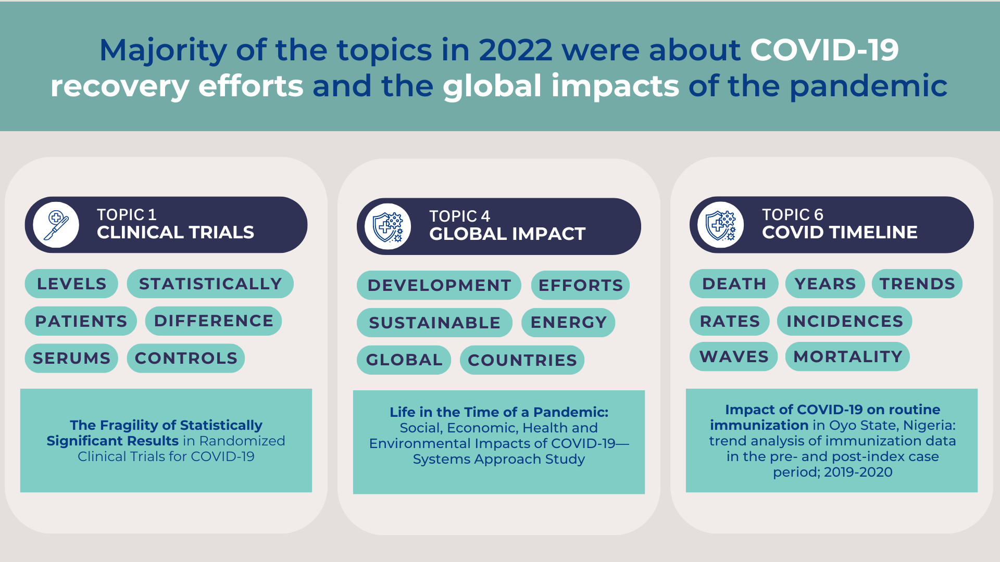

<center><small><b>Figure 22.</b> Majority Topics in 2022</small></center>

In [17]:
file_2022 = open("display_lda_2022.pkl",'rb')
topics_2022 = pickle.load(file_2022)
topics_2022

<center><small><b>Figure 23.</b> pyLDAvis for 2022</small></center>

<b style='color:#64928E'>In 2022, research continued to grapple with the vast and varied impacts of the COVID-19 pandemic</b>. Topic 1 sheds light on the results and challenges of clinical trials, emphasizing the need for strong statistical methods. Topic 4 broadens the view to consider the pandemic's socio-economic, health, and environmental consequences, pointing to the importance of adopting sustainable solutions. Topic 6 looks back over the timeline of the pandemic, tracking mortality trends and the broader effects on public health infrastructure. Together, these topics highlight how deeply the pandemic has influenced global discussions and policy decisions as the world seeks pathways to recovery.

<div id="conclusion" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">CONCLUSION</h1></center>
</div>

To summarize, the team has demonstrated the benefits of using topic modeling and topic evolution to address the problem statement. Latent Dirichlet Allocation (LDA), along with its visualization package pyLDAvis, enabled the team to effectively detect and label various topics found within different COVID-19 time periods. Specifically, the technique accomplished two key tasks:
 
<b style='color:#073C84'>Threat Identification.</b> By examining topics with low marginal distributions, we can identify emerging subjects that researchers should explore to anticipate future threats. <b style='color:#64928E'>Identifying these topics is crucial because it enables the early detection of potential issues that may not yet be widely recognized</b>. This early recognition allows researchers to prioritize these areas, ensuring that resources and efforts are directed toward understanding and mitigating these threats. As a result, preventive measures can be implemented more swiftly, potentially reducing the impact of these emerging threats on public health and safety.
 
<b style='color:#073C84'>Trend Analysis.</b> By identifying larger topics, researchers can explore popular subjects, <b style='color:#64928E'>enabling them to predict new projects or research areas</b>. Additionally, as these studies are often replicated, they can facilitate collaborations among researchers, leading to more insightful outputs.

<div id="limits-recos" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">SCOPE AND LIMITATIONS</h1></center>
</div>

The scope of the study spanned from 2018 to 2023, focusing exclusively on abstracts that exceeded 100 words and were written in English. The primary topic modeling technique employed was Latent Dirichlet Allocation (LDA), chosen for its interpretability, particularly when visualized through pyLDAvis. However, this approach came with certain limitations. The study did not compare LDA with other topic modeling techniques such as Non-negative Matrix Factorization, Word2Vec, or Clustering, primarily due to LDA's advantage in terms of interpretability. Additionally, only the term frequency of tokens was analyzed, as opposed to using Term Frequency-Inverse Document Frequency (TF-IDF), which tended to produce broader and less interpretable topics.

<div id="limits-recos" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">WAY FORWARD</h1></center>
</div>

<b style='color:#073C84'>Full-text data.</b> Due to limitations in computing power caused by budget constraints, the team was unable to utilize the full-text of the CORD-19 dataset and had to rely solely on the abstracts. Future researchers are encouraged to explore this recommendation as it may offer insights beyond what the abstracts provide. It is important to note that while abstracts offer a summary of the research, the full-text provides more detailed explanations. Using LDA on the full-text could lead to a more precise labeling of the proportion of topics present in the research.

<b style='color:#073C84'>Metrics for optimization.</b> Due to time constraints, the team could not fully explore perplexity and log likelihood for determining the ideal number of topics in our model, relying instead on pyLDAvis insights. It is recommended that future researchers use perplexity and log likelihood to guide parameter tuning, potentially improving results. Perplexity measures how well the model predicts unseen or held-out documents, aiding in finding parameters that better generalize or classify documents into topics (Bismi, 2023). Similarly, log likelihood evaluates how accurately LDA generates documents that closely reconstruct the corpus and classifies them correctly. Using both metrics provides a numerical basis for tuning LDA's hyperparameters, leading to more accurate and meaningful topic models (Chris, 2021).

<b style='color:#073C84'>Grid Search.</b> The team was unable to conduct comprehensive testing of multiple versions of the LDA using various hyperparameters. The 'Online' optimizer was employed for the LDA model, chosen for its ability to handle large datasets thanks to its stochastic or batched nature (Hoffman et al., 2010). However, the effectiveness of online LDA hinges on its hyperparameters and learning rates (Zhai & Boyd-Graber, n.d.). In future research, a grid search could be employed to test several hyperparameters, enabling the selection of the best model for the dataset.
                                                                                                                     
<b style='color:#073C84'>Apply LDA on the whole Dataset.</b> In this project, LDA was applied separately for each year from 2018 to 2023. The team sees an opportunity to consolidate all abstracts, regardless of the year, into a single LDA model. While this approach may yield more general results, it can still provide valuable insights by showing the overall focus of studies during the pandemic. This broader view can guide governments and institutions in identifying under-researched areas. The team encourages researchers to apply this improvement for a more comprehensive analysis.

<div id="references" style="background-color:#80CDC6 ; padding: 10px 0;">
    <center><h1 style="color:#342E5B; font-weight:bold">REFERENCES</h1></center>
</div>

* Bismi, I. (15, May 2023). *Topic Modelling using LDA.* Retrieved from: https://medium.com/@iqra.bismi/topic-modelling-using-lda-fe81a2a806e0
* Cabico, G. (21, May 2024). *DOH: Philippines keeps low COVID-19 risk despite rise in cases.* Retrieved from: https://www.philstar.com/headlines/2024/05/21/2356805/doh-philippines-keeps-low-covid-19-risk-despite-rise-cases
* Centers for Disease Control and Prevention. (n.d.). *Variant Proportions.* Retrieved from: https://covid.cdc.gov/covid-data-tracker/#variant-summary
* Chris. (7, March 2021). *Parameter Estimation for Latent Dirichlet Allocation explained with Collapsed Gibbs Sampling in Python.* Retrieved from: https://medium.com/@datastories/parameter-estimation-for-latent-dirichlet-allocation-explained-with-collapsed-gibbs-sampling-in-1d2ec78b64c
* Ganegedara, T. (23, August 2018). *Intuitive Guide to Latent Dirichlet Allocation.* Retrieved from: https://towardsdatascience.com/light-on-math-machine-learning-intuitive-guide-to-latent-dirichlet-allocation-437c81220158
* Hoffman, M., Blei, D. M., & Bach, F. (2010, December 6). Online learning for Latent Dirichlet Allocation. *NIPS'10: Proceedings of the 23rd International Conference on Neural Information Processing Systems - Volume 1* (pp. 856-864). Retrieved from: https://dl.acm.org/doi/10.5555/2997189.2997285.
* Hui, D., et al. (August 2018). Middle East respiratory syndrome coronavirus: risk factors and determinants of primary, household, and nosocomial transmission. *Lancet Infect Dis. 8*(8): e217–e227. Retrieved from: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7164784/
* ILO, FAO, IFAD & WHO. (13, October 2020). *Impact of COVID-19 on people's livelihoods, their health and our food systems.* https://www.who.int/news/item/13-10-2020-impact-of-covid-19-on-people's-livelihoods-their-health-and-our-food-systems
* Macusi, E., et al. (2022, February 15). Impact of COVID-19 and closed fishing season on commercial fishers of Davao Gulf, Mindanao, Philippines. *Ocean and Coastal Management, 217,* 105997. https://doi.org/10.1016/j.ocecoaman.2021.105997
* National Library of Medicine. (n.d.). *PMC COVID-19 Collection.* Retrieved from: https://www.ncbi.nlm.nih.gov/pmc/about/covid-19/
* Nature Index. (28, August 2020). *COVID-19 research update: How many pandemic papers have been published? A briefing on developments in coronavirus research publishing.* Retrieved from: https://www.nature.com/nature-index/news/how-coronavirus-is-changing-research-practices-and-publishing
* Rogin, J. (3, August 2021). *In 2018, Diplomats Warned of Risky Coronavirus Experiments in a Wuhan Lab. No One Listened. After seeing a risky lab, they wrote a cable warning to Washington. But it was ignored.* https://www.politico.com/news/magazine/2021/03/08/josh-rogin-chaos-under-heaven-wuhan-lab-book-excerpt-474322
* Wang, L.L., Lo, K., Chandrasekhar, Y., Reas, R., Yang, J., Eide, D., Funk, K., Kinney, R.M., Liu, Z., Merrill, W., Mooney, P., Murdick, D.A., Rishi, D., Sheehan, J., Shen, Z., Stilson, B., Wade, A.D., Wang, K., Wilhelm, C., Xie, B., Raymond, D.A., Weld, D.S., Etzioni, O., & Kohlmeier, S. (2020). *CORD-19: The Covid-19 Open Research Dataset.* ArXiv. Retrieved from: https://www.semanticscholar.org/reader/bc411487f305e451d7485e53202ec241fcc97d3b
* Yale Medicine. (n.d.). *COVID-19.* Retrieved from: https://www.yalemedicine.org/conditions/covid-19#:~:text=What%20are%20the%20origins%20of,live%20animal%20market%20in%20Wuhan.
* Zhai, K., & Boyd-Graber, J. (2013). Online Latent Dirichlet Allocation with Infinite Vocabulary. *Proceedings of the 30th International Conference on Machine Learning. Atlanta, Georgia, USA: JMLR: W&CP, volume 28.* Retrieved from https://proceedings.mlr.press/v28/zhai13.pdf.